In [1]:
import matplotlib.pyplot as plt
import numpy as np
from JSAnimation.JSAnimation import IPython_display
from matplotlib import animation
from matplotlib import gridspec
import gauge

In [2]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib



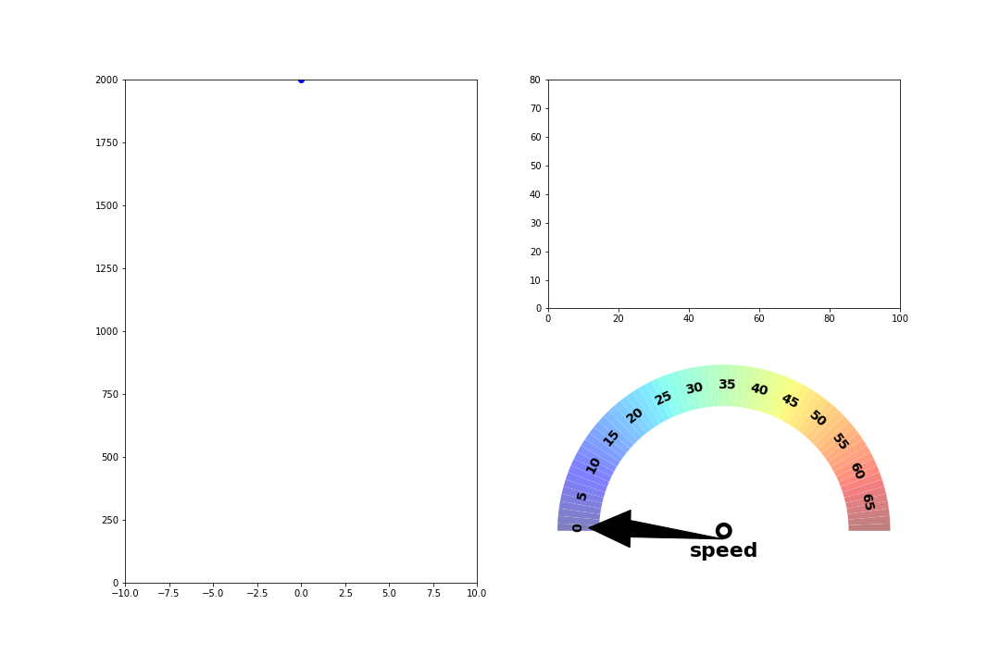
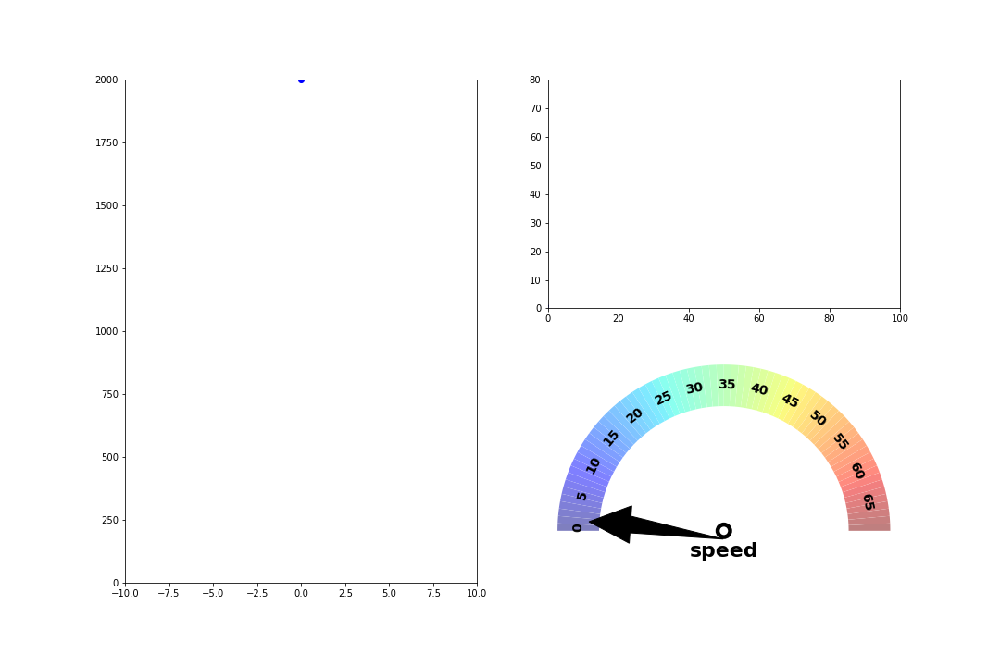
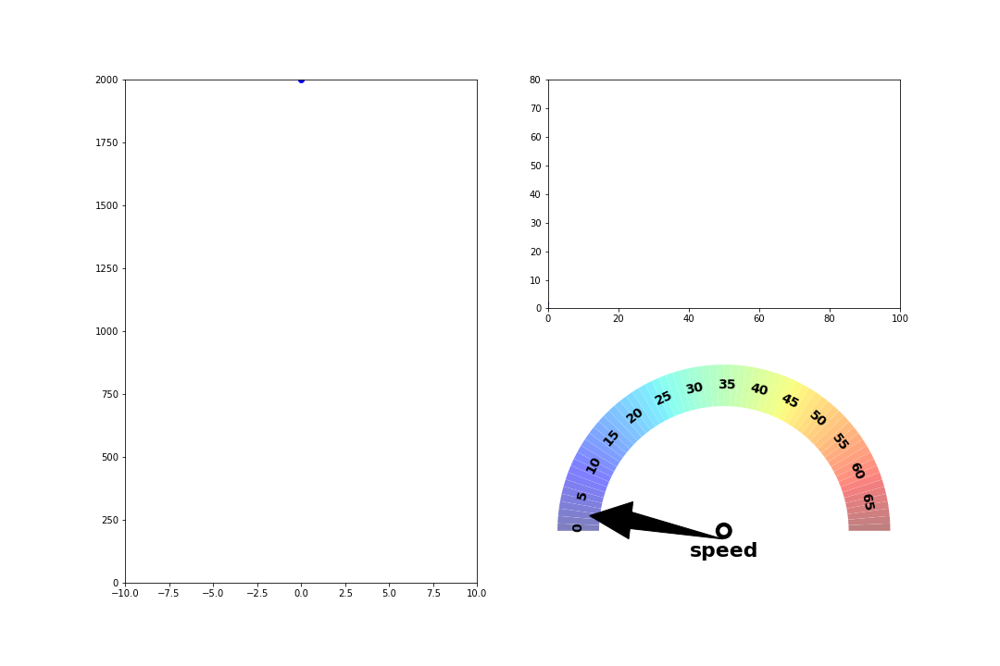
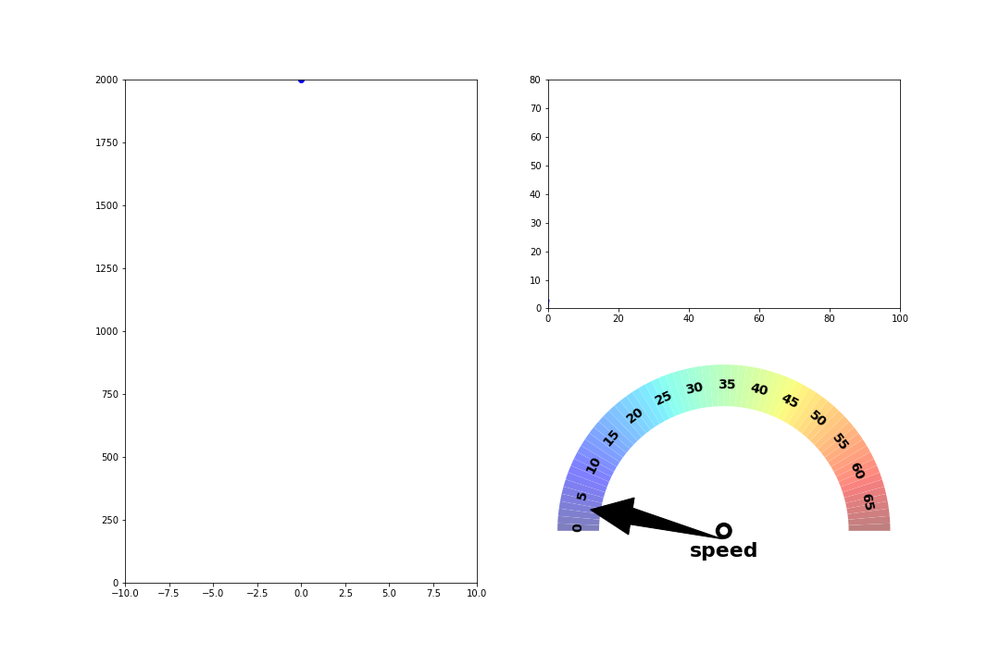
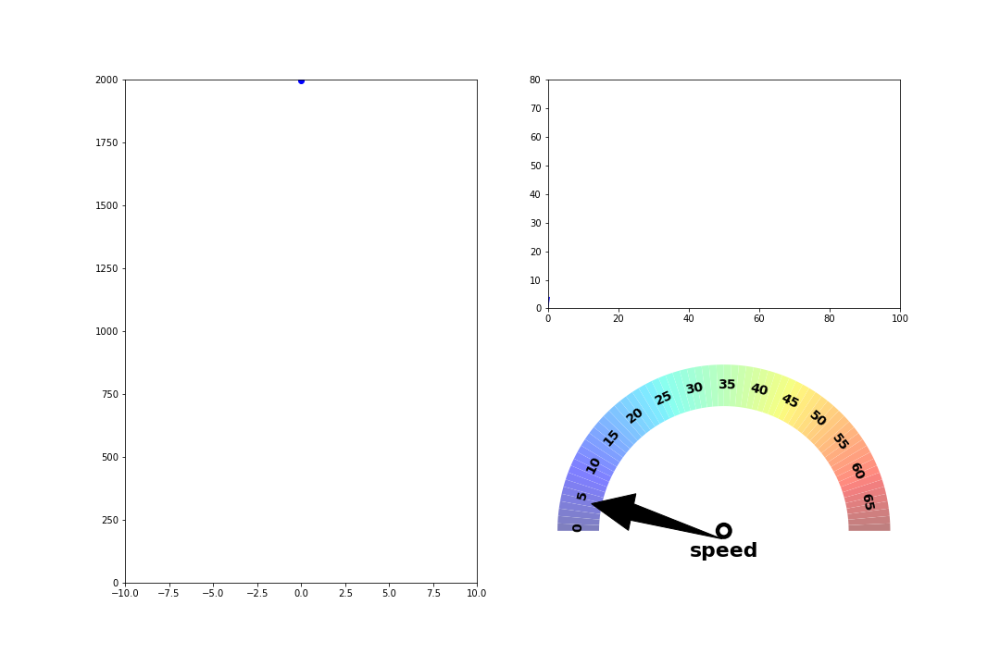
...
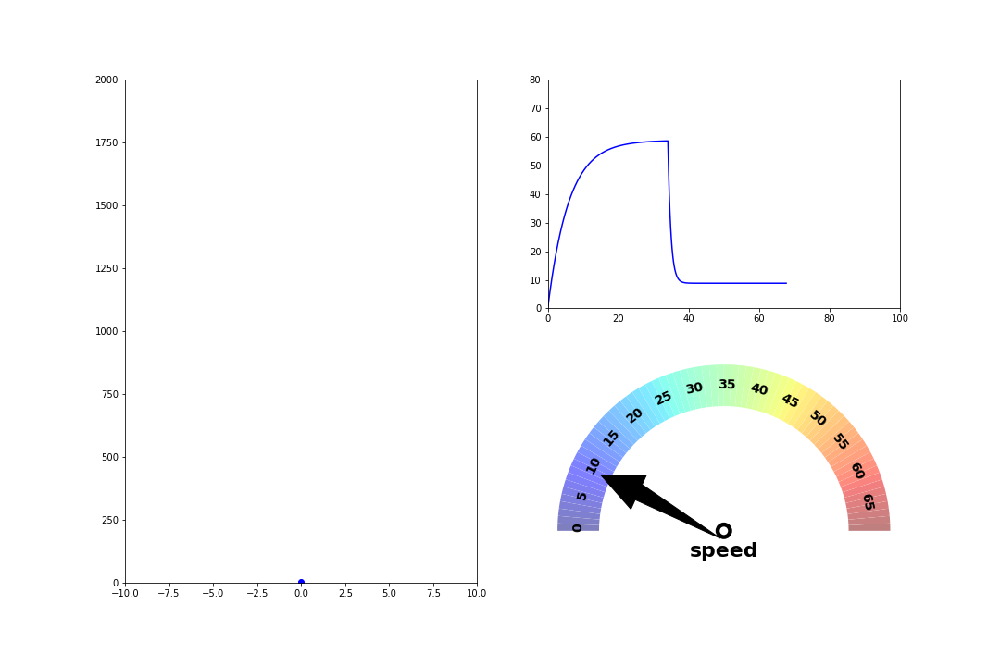
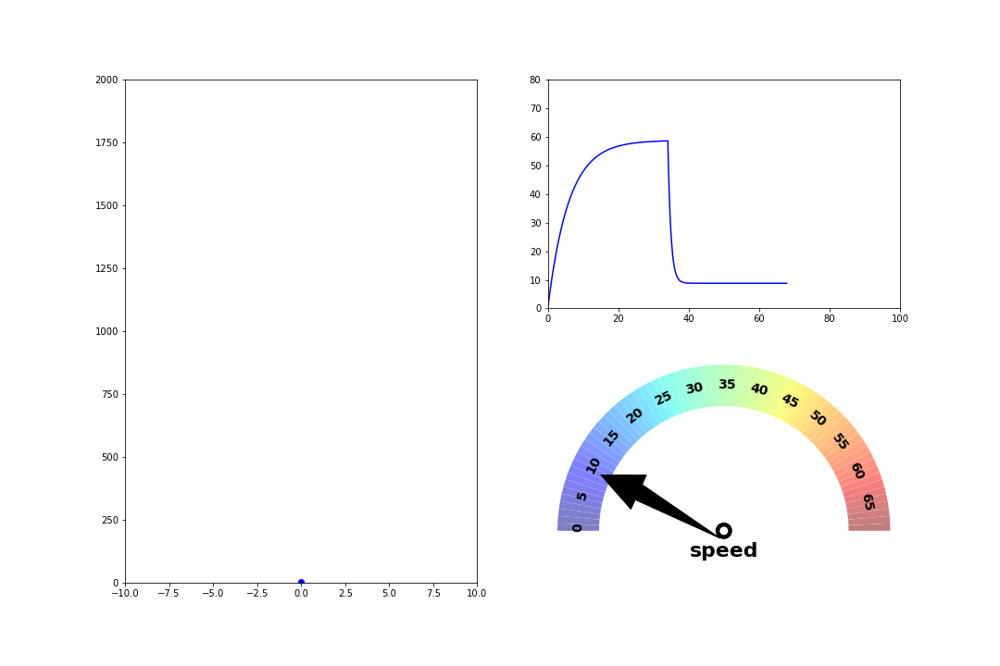
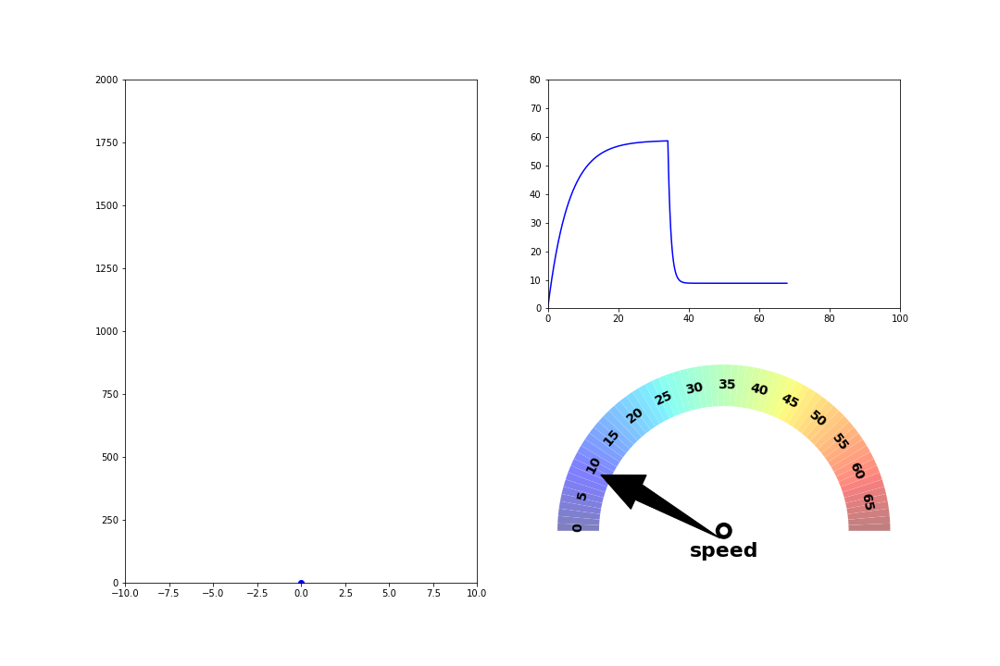
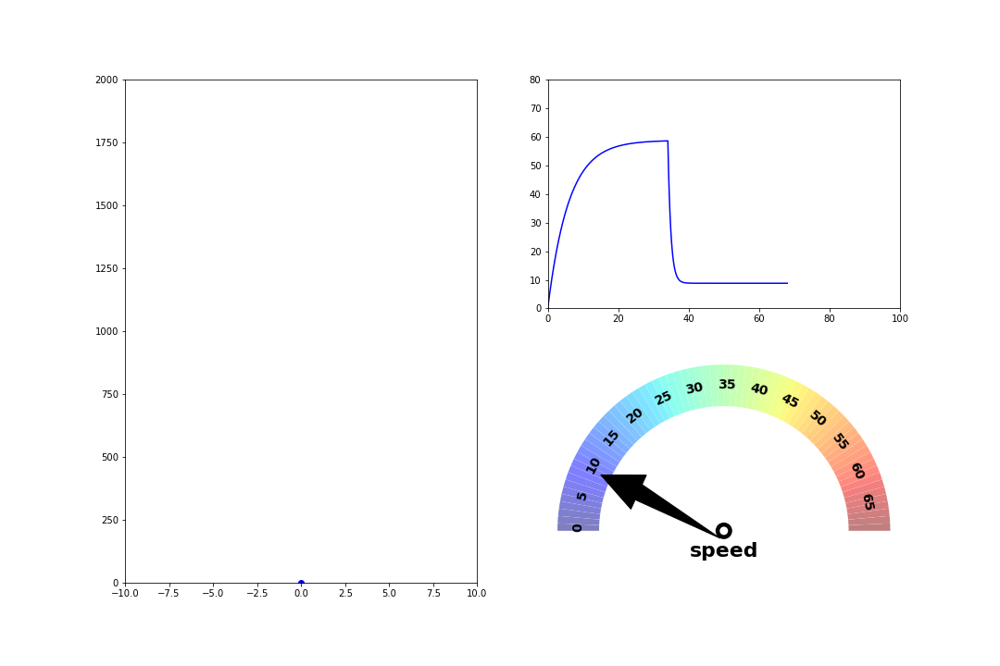
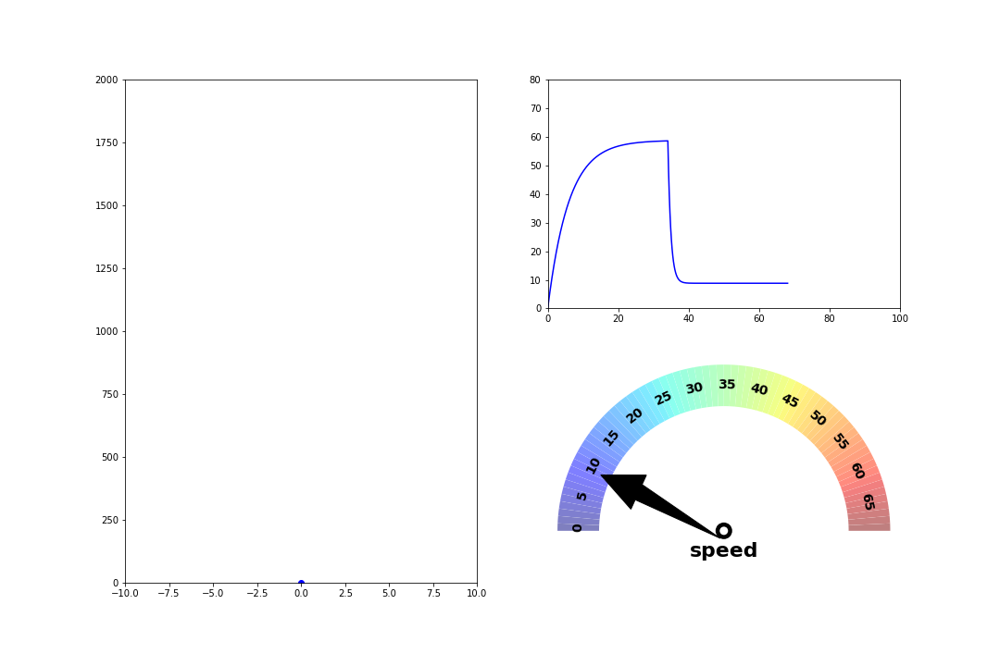

In [8]:
dt=0.1 #tamanho do passo de tempo
t_final=200
g=9.81 # m/s^2
k=15 # resistencia do ar kg/s de queda livre
m=90 # kilos
v_0=0 #velocidade inicial
y_0=2000 #altura incial

def f(v,k): # dv é uma função de 
    return g-k*v/m

# Gráfico
fig1 = plt.figure(figsize=(15,10))
gs = gridspec.GridSpec(2, 2) 

# Gráfico da posição
ax1 = fig1.add_subplot(gs[:, 0])
ax1.set_xlim((-10, 10))
ax1.set_ylim((0, 2000))
pts, = ax1.plot([], [], 'o', c='b')

# Gráfico da velocidade x t
ax2 = fig1.add_subplot(gs[0,1])
ax2.set_xlim((0, 100))
ax2.set_ylim((0, 80))
line, = ax2.plot([], [], c='b')

# Velocímetro
ax3 = fig1.add_subplot(gs[1,1])
arrow = gauge.gauge(ax3, labels=list(range(0,70)), colors='jet_r', cat=round(1), title='speed') 

v=v_0
y=y_0
t=0

def calculate_parachute(y,v,t,k):
    y_list = [y]
    v_list = [v]
    t_list = [t]
    #antes de abrir paraquedas
    while(y>350):

        y_next = y - dt*v
        v_next = v + dt*f(v,k)
        #ax2.plot([t, t+dt], [v, v_next],c='b')
        #ax1.scatter(0,y_next,c='b')
        y=y_next
        v=v_next
        t=t+dt
        y_list.append(y)
        v_list.append(v)
        t_list.append(t)

    #depois de abrir paraquedas e antes de cair no chao
    k=100 # resistencia do ar com um paraquedas
    while(y>0):
        y_next = y - dt*v
        v_next = v + dt*f(v,k)
        #ax2.plot([t, t+dt], [v, v_next],c='b')
        #ax1.scatter(0,y_next,c='b')
        y=y_next
        v=v_next
        t=t+dt
        y_list.append(y)
        v_list.append(v)
        t_list.append(t)
        
    return y_list, v_list, t_list

y_list, v_list, t_list = calculate_parachute(y,v,t,k)

def init():
    return pts, line, arrow

t_data = []
v_data = []

def animate(i):
    t_data.append(t_list[i])
    v_data.append(v_list[i])
    line.set_data(t_data, v_data)
    pts.set_data(0, y_list[i])
    ax3.clear()
    arrow = gauge.gauge(ax3, labels=list(range(0,70)), colors='jet_r', cat=round(v_list[i]+1), title='speed')
    fig1.canvas.draw()
    return pts, line, arrow

animation.FuncAnimation(fig1, animate, init_func=init,
                        frames=len(y_list), interval=30, blit=True)  